In [88]:
# Link to the challenge : https://www.aapm.org/grandchallenge/lowdosect/

In [89]:
low_dose_ct_training_dataset_dir = '../../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data'
low_dose_ct_testing_dataset_dir = '../../../../Dataset/LowDoseCTGrandChallenge/Testing_Image_Data'

In [90]:

import os
import numpy as np
import tensorflow as tf
from glob import glob
import matplotlib.pylab as plt
from PIL import Image
import pydicom

In [91]:
training_filepaths_x = []   # i.e the QD (quarter dose) images (noisy images)
training_filepaths_y = []   # i.e the FD (full dose) images (clean images)

for root, folder_name, file_names in os.walk(low_dose_ct_training_dataset_dir):
    for file_name in file_names:
        file_path = os.path.join(root, file_name)
        
        if "QD" in file_name:
            training_filepaths_x.append(file_path)
        elif "FD" in file_name:
            training_filepaths_y.append(file_path)
            
training_filepaths_x.sort()
training_filepaths_y.sort()

In [92]:
print('[Training] number of noisy images (QD) : ', len(training_filepaths_x))
print('[Training] number of clean images (FD) : ', len(training_filepaths_y))

[Training] number of noisy images (QD) :  16627
[Training] number of clean images (FD) :  16628


In [93]:
testing_filepaths_x = []   # i.e the QD (quarter dose) images (noisy images)
testing_filepaths_y = []   # i.e the FD (full dose) images (clean images)

for root, folder_name, file_names in os.walk(low_dose_ct_testing_dataset_dir):
    for file_name in file_names:
        file_path = os.path.join(root, file_name)
        
        if "QD" in file_name:
            testing_filepaths_x.append(file_path)
        elif "FD" in file_name:
            testing_filepaths_y.append(file_path)
            
testing_filepaths_x.sort()
testing_filepaths_y.sort()

In [94]:
print('[Testing] number of noisy images (QD) : ', len(testing_filepaths_x))
print('[Testing] number of clean images (FD) : ', len(testing_filepaths_y))

[Testing] number of noisy images (QD) :  20938
[Testing] number of clean images (FD) :  0


In [95]:
# Visualization of few image pairs (noisy and clean)

print(training_filepaths_x[0], '\n', training_filepaths_y[0])

../../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data\1mm B30\QD_1mm\quarter_1mm\L067\quarter_1mm\L067_QD_1_1.CT.0003.0001.2015.12.22.18.10.55.420810.358276339.IMA 
 ../../../../Dataset/LowDoseCTGrandChallenge/Training_Image_Data\1mm B30\FD_1mm\full_1mm\L067\full_1mm\L067_FD_1_1.CT.0001.0001.2015.12.22.18.09.40.840353.358074219.IMA


In [96]:
def load_scan(path):
    # referred from https://www.kaggle.com/gzuidhof/full-preprocessing-tutorial
    slices = [pydicom.read_file(path)]
    return slices


def get_pixels_hu(slices):
    # referred from https://www.kaggle.com/gzuidhof/full-preprocessing-tutorial
    image = np.stack([s.pixel_array for s in slices])
    image = image.astype(np.int16)
    image[image == -2000] = 0
    for slice_number in range(len(slices)):
        intercept = slices[slice_number].RescaleIntercept
        slope = slices[slice_number].RescaleSlope
        if slope != 1:
            image[slice_number] = slope * image[slice_number].astype(np.float64)
            image[slice_number] = image[slice_number].astype(np.int16)
        image[slice_number] += np.int16(intercept)
    return np.int16(image)

def read_image(image_path):
    full_pixels =get_pixels_hu(load_scan(image_path))
    
    MIN_B= -1024.0
    MAX_B= 3072.0
    data = (full_pixels - MIN_B) / (MAX_B - MIN_B)
    
    return np.squeeze(np.expand_dims(data, axis=-1))
     

def denormalize(image):
    img = image.copy()
    MIN_B= -1024.0
    MAX_B= 3072.0    

    return img * (MAX_B - MIN_B) + MIN_B

def trunc(mat):
    min = -160.0
    max = 240.0
    
    mat[mat <= min] = min
    mat[mat >= max] = max
    return mat
    

(512, 512)
(512, 512)
0.576171875 0.0
1336.0 -1024.0


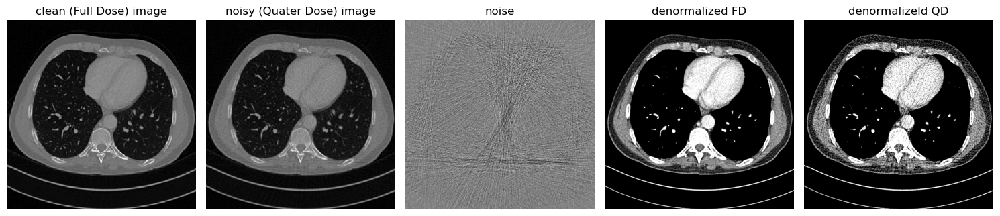

(512, 512)
(512, 512)
0.587646484375 0.0
1383.0 -1024.0


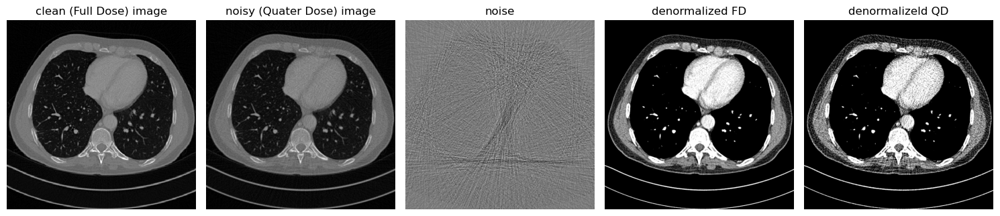

(512, 512)
(512, 512)
0.5625 0.0
1280.0 -1024.0


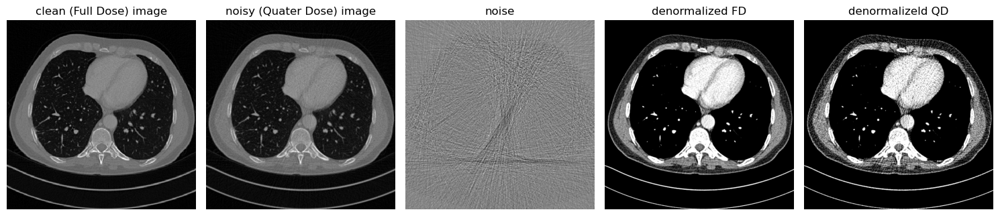

(512, 512)
(512, 512)
0.59765625 0.0
1424.0 -1024.0


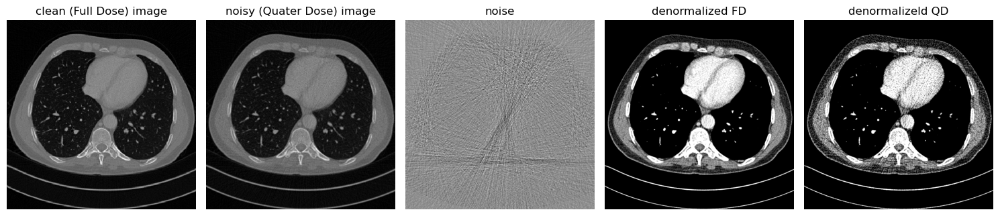

(512, 512)
(512, 512)
0.59716796875 0.0
1422.0 -1024.0


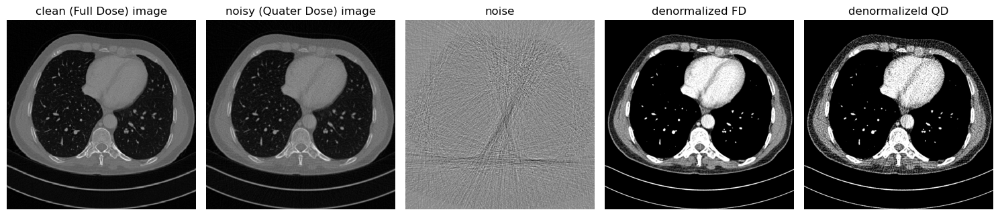

(512, 512)
(512, 512)
0.614013671875 0.0
1491.0 -1024.0


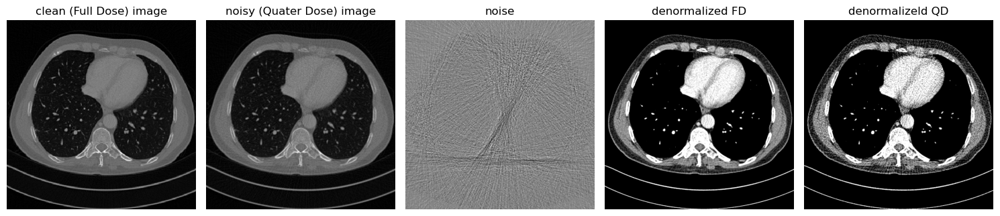

(512, 512)
(512, 512)
0.62353515625 0.0
1530.0 -1024.0


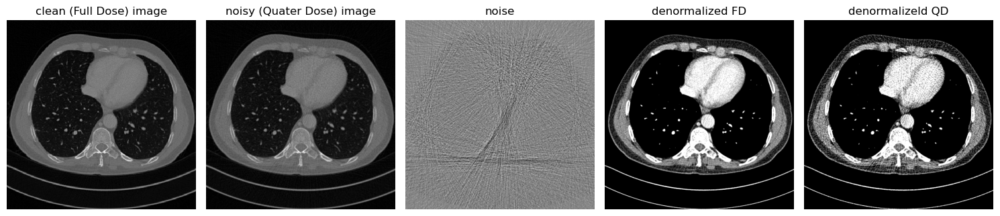

(512, 512)
(512, 512)
0.62353515625 0.0
1530.0 -1024.0


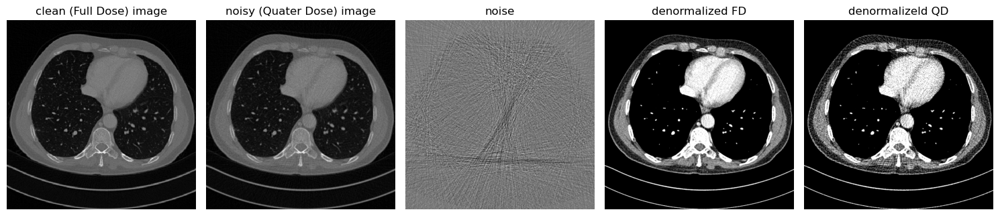

(512, 512)
(512, 512)
0.62255859375 0.0
1526.0 -1024.0


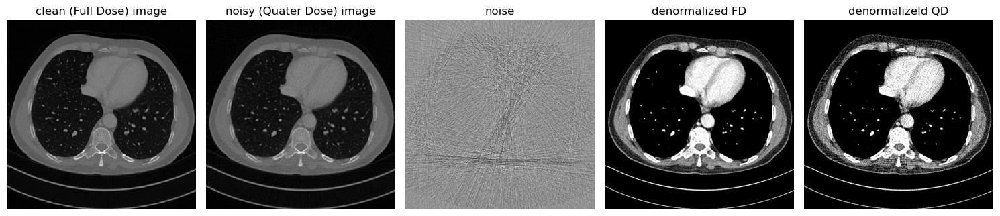

(512, 512)
(512, 512)
0.654541015625 0.0
1657.0 -1024.0


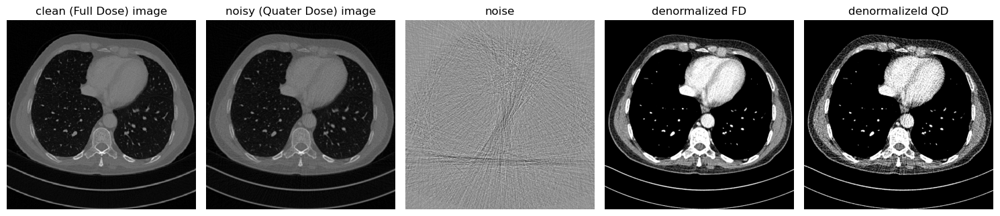

In [97]:
for i in range(0, 10):
    noisy_image = read_image(training_filepaths_x[i])
    clean_image = read_image(training_filepaths_y[i])
    
    print(noisy_image.shape)
    print(clean_image.shape)
        
    print(np.max(noisy_image), np.min(noisy_image))
    
    den = denormalize(noisy_image.copy())
    print(np.max(den), np.min(den))
    
    fig, axs = plt.subplots(1, 5, figsize=(15, 8))
    
    axs[0].set_title('clean (Full Dose) image')
    axs[0].imshow(clean_image, cmap='gray', interpolation='None')
    axs[0].axis('off')  # Turn off axis labels
    
    axs[1].set_title('noisy (Quater Dose) image')
    axs[1].imshow(noisy_image, cmap='gray')
    axs[1].axis('off')  # Turn off axis labels
    
    axs[2].set_title('noise')
    axs[2].imshow(noisy_image - clean_image, cmap='gray')
    axs[2].axis('off')  # Turn off axis labels
    
    axs[3].set_title('denormalized FD')
    axs[3].imshow(trunc(denormalize(clean_image)), cmap='gray', vmin=-160.0, vmax=240.0)
    axs[3].axis('off')  # Turn off axis labels
    
    
    axs[4].set_title('denormalizeld QD')
    axs[4].imshow(trunc(denormalize(noisy_image)), cmap=plt.cm.gray, vmin=-160.0, vmax=240.0)
    axs[4].axis('off')  # Turn off axis labels
    
    
    
    plt.tight_layout()
    
    plt.show()

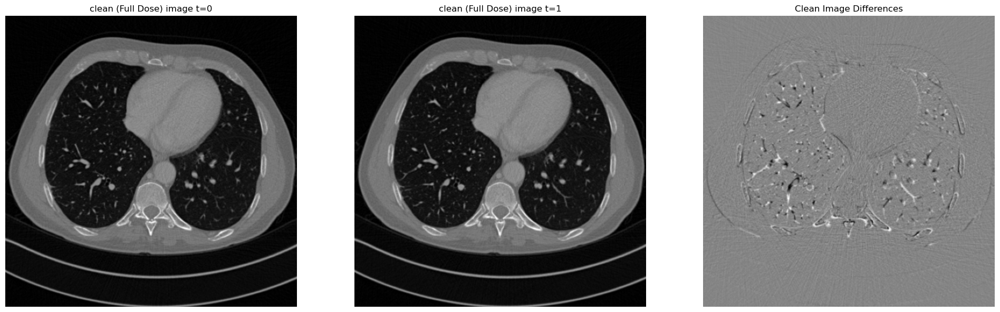

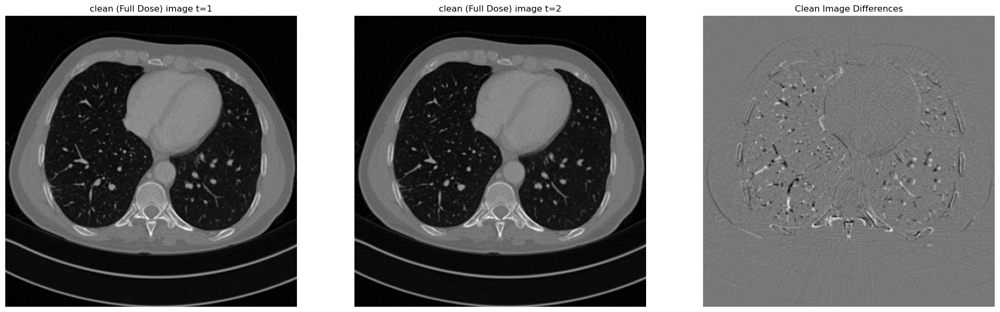

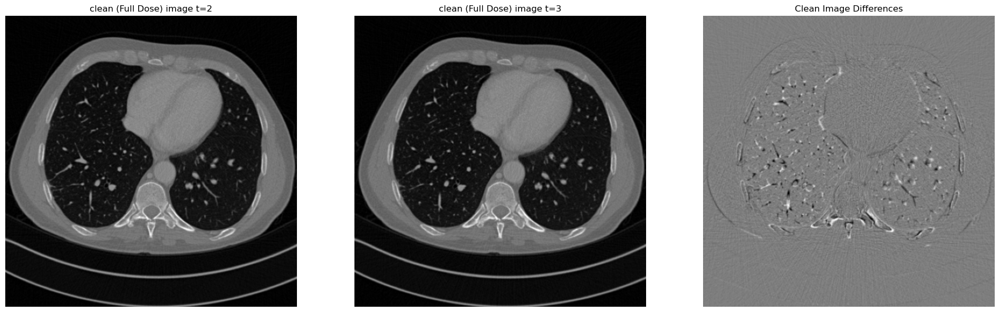

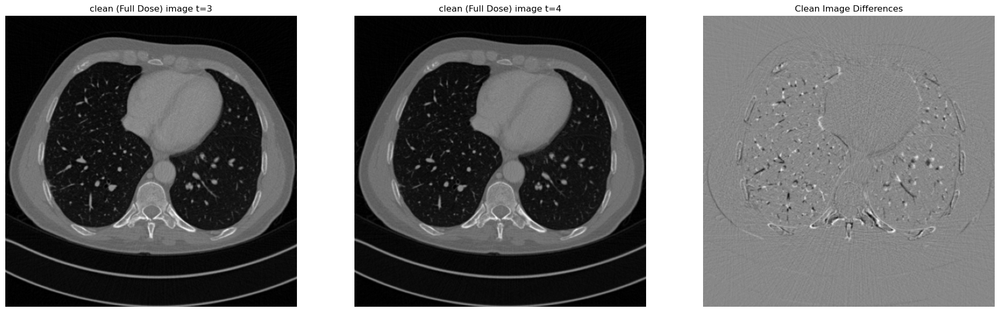

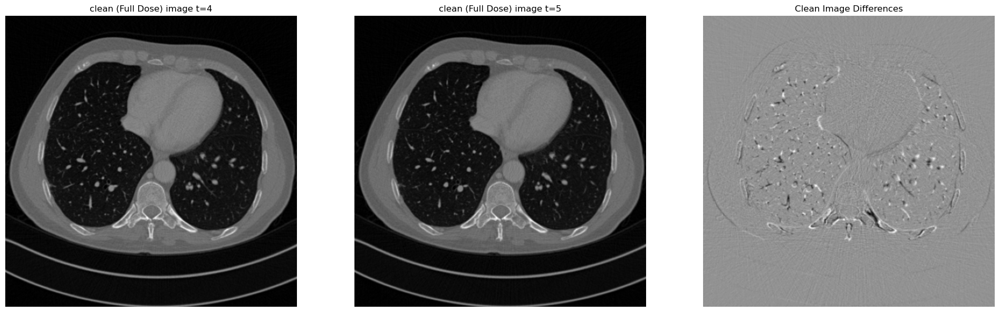

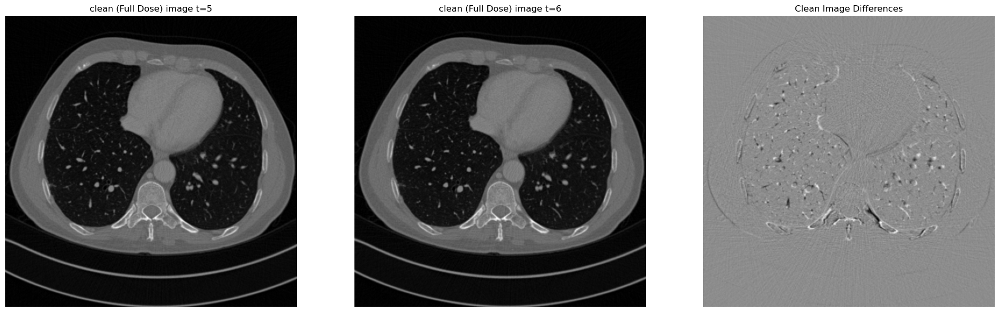

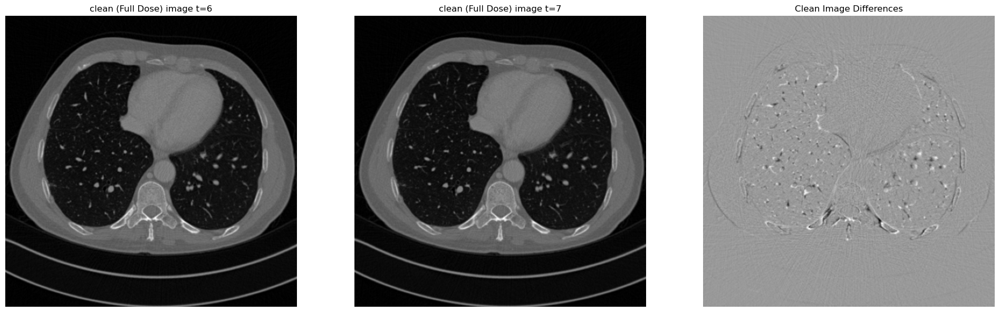

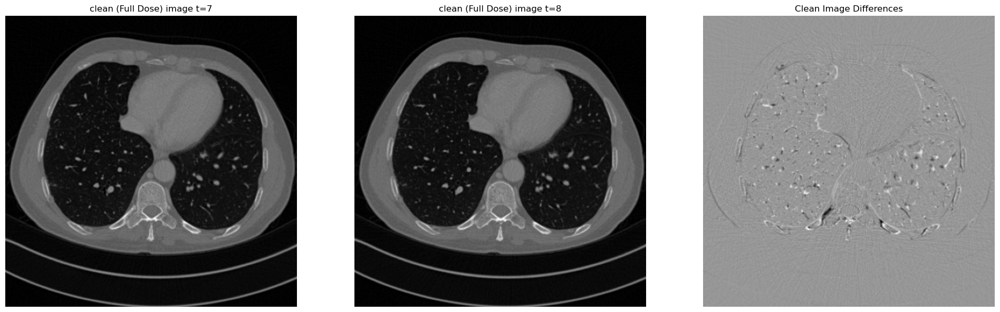

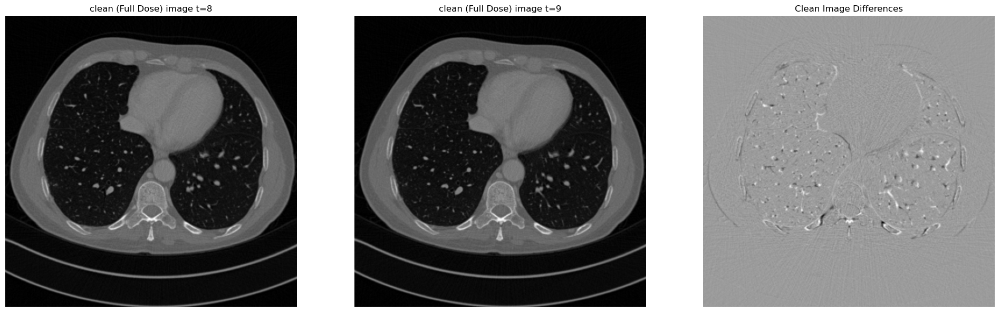

In [98]:
for i in range(9):
    noisy_image_0 = read_image(training_filepaths_x[i])
    clean_image_0 = read_image(training_filepaths_y[i])
    
    noisy_image_1 = read_image(training_filepaths_x[i + 1])
    clean_image_1 = read_image(training_filepaths_y[i + 1])
    
    fig, axs = plt.subplots(1, 3, figsize=(20, 6))  # Adjust figsize as needed
    
    # Display clean_image_0
    axs[0].set_title('clean (Full Dose) image t=' + str(i))
    axs[0].imshow(clean_image_0, cmap='gray')
    axs[0].axis('off')  # Turn off axis labels
    
    # Display clean_image_1
    axs[1].set_title('clean (Full Dose) image t=' + str(i + 1))
    axs[1].imshow(clean_image_1, cmap='gray')
    axs[1].axis('off')  # Turn off axis labels
    
    # Display the difference between clean_image_1 and clean_image_0
    axs[2].set_title('Clean Image Differences')
    axs[2].imshow(clean_image_1 - clean_image_0, cmap='gray')
    axs[2].axis('off')  # Turn off axis labels
    
    plt.tight_layout()
    plt.show()


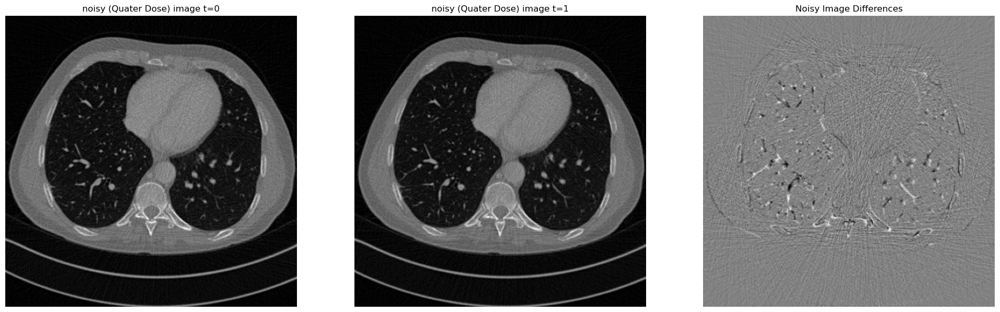

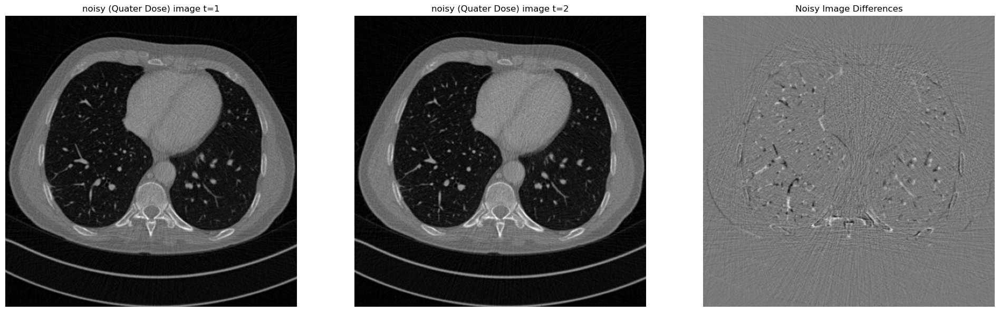

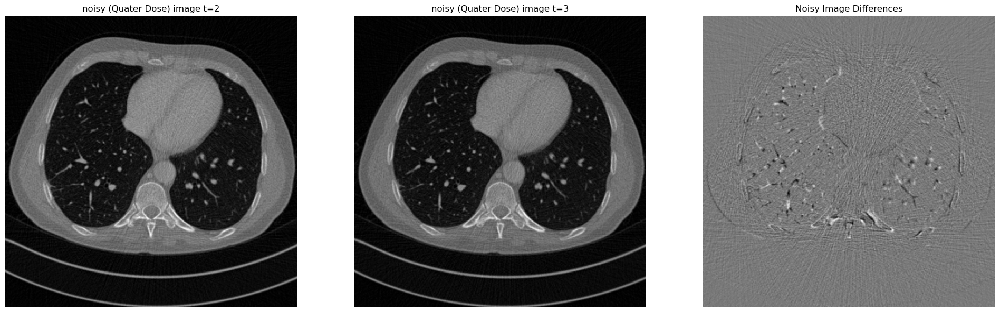

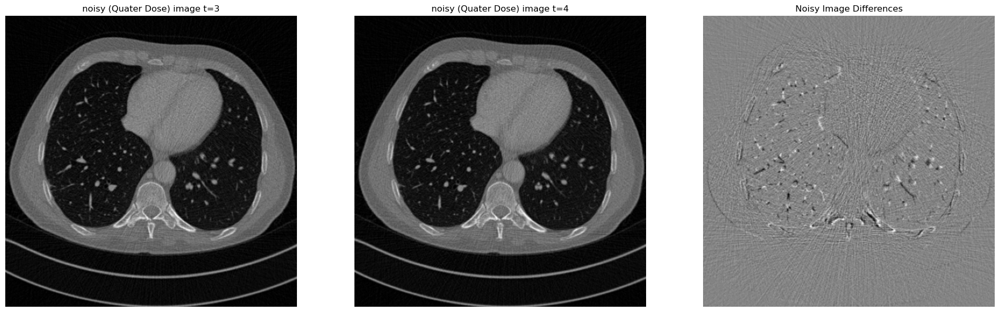

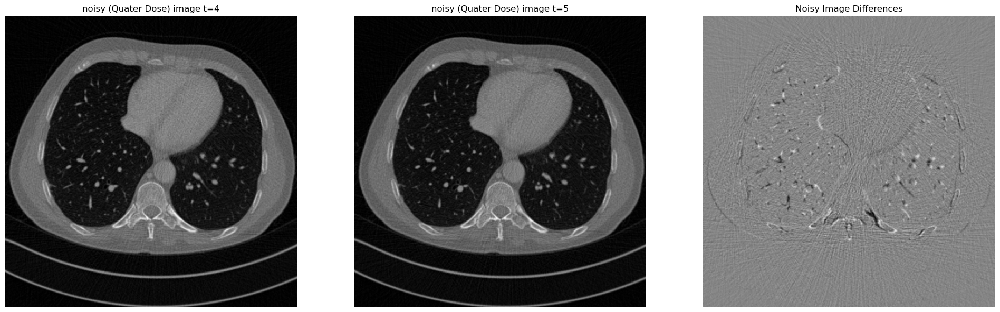

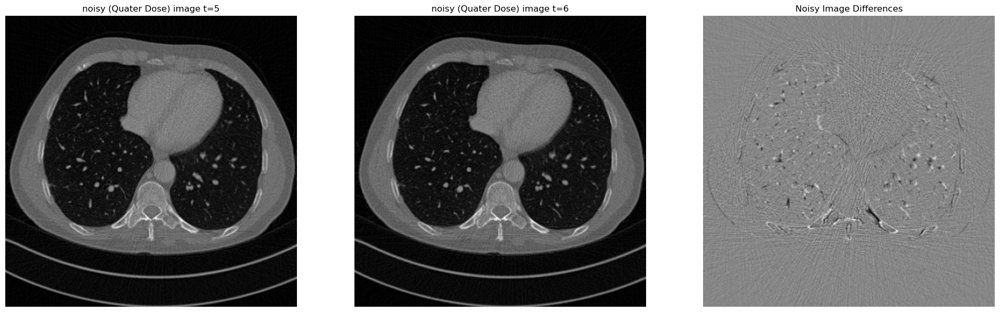

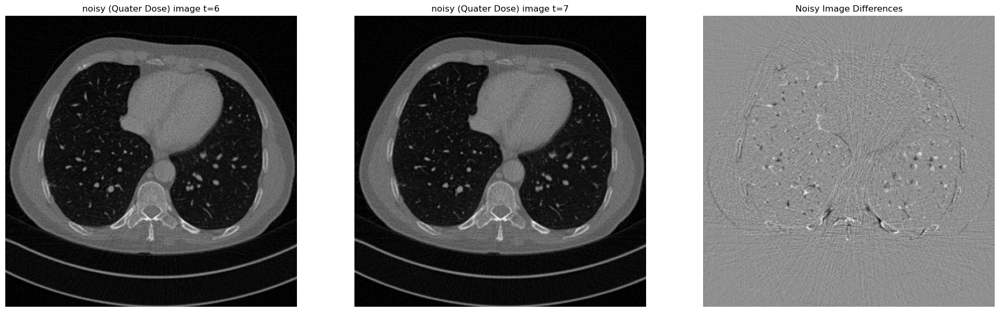

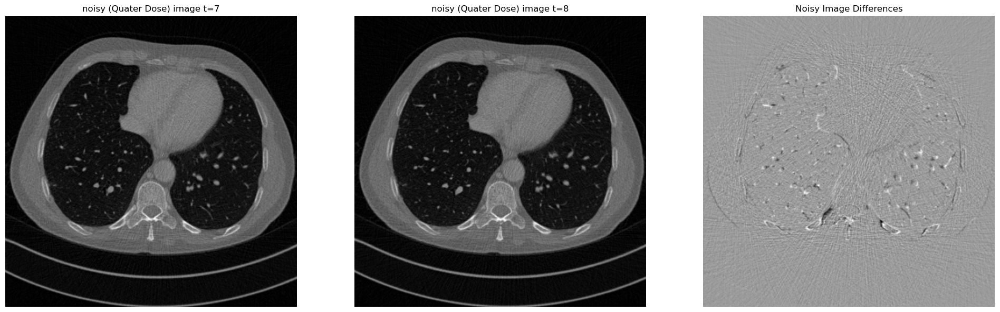

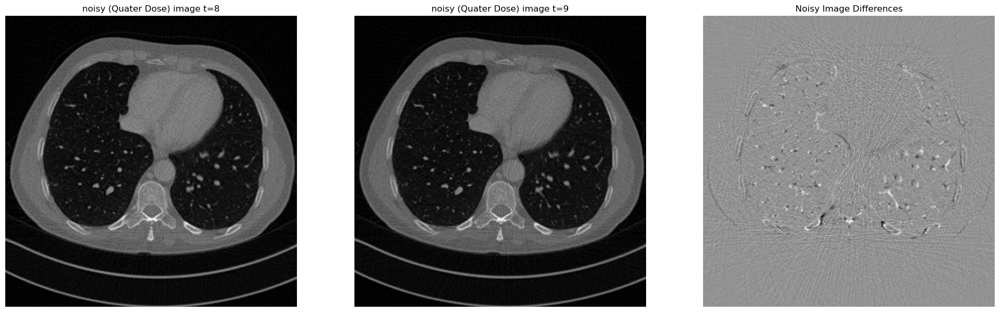

In [99]:
for i in range(9):
    noisy_image_0 = read_image(training_filepaths_x[i])
    clean_image_0 = read_image(training_filepaths_y[i])
    
    noisy_image_1 = read_image(training_filepaths_x[i + 1])
    clean_image_1 = read_image(training_filepaths_y[i + 1])
    
    fig, axs = plt.subplots(1, 3, figsize=(20, 6))  # Adjust figsize as needed
    
    # Display noisy_image_0
    axs[0].set_title('noisy (Quater Dose) image t=' + str(i))
    axs[0].imshow(noisy_image_0, cmap='gray')
    axs[0].axis('off')  # Turn off axis labels
    
    # Display clean_image_1
    axs[1].set_title('noisy (Quater Dose) image t=' + str(i + 1))
    axs[1].imshow(noisy_image_1, cmap='gray')
    axs[1].axis('off')  # Turn off axis labels
    
    axs[2].set_title('Noisy Image Differences')
    axs[2].imshow(noisy_image_1 - noisy_image_0, cmap='gray')
    axs[2].axis('off')  # Turn off axis labels
    
    plt.tight_layout()
    plt.show()


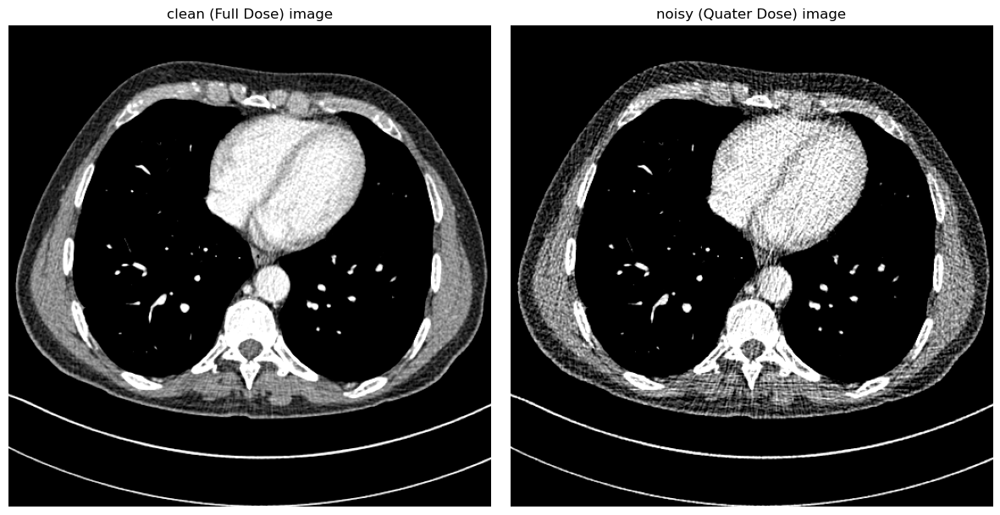

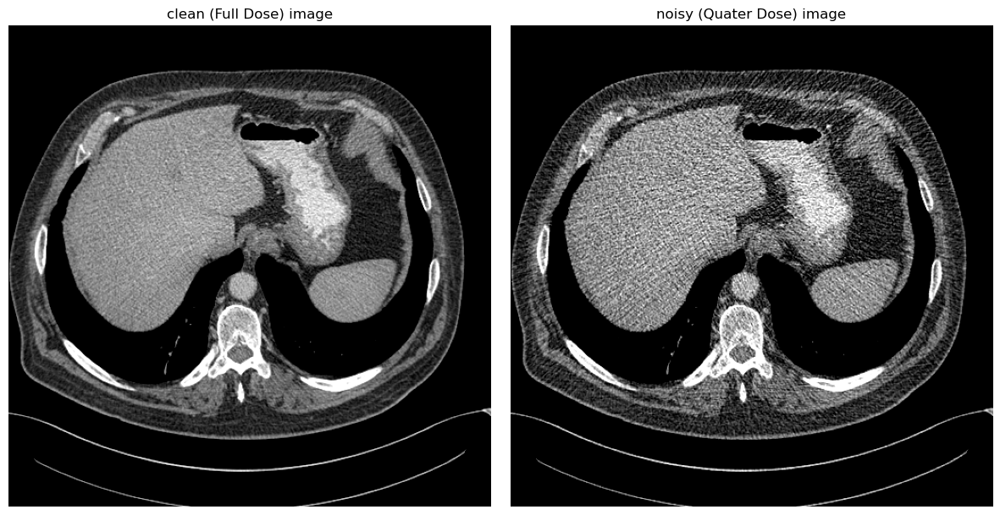

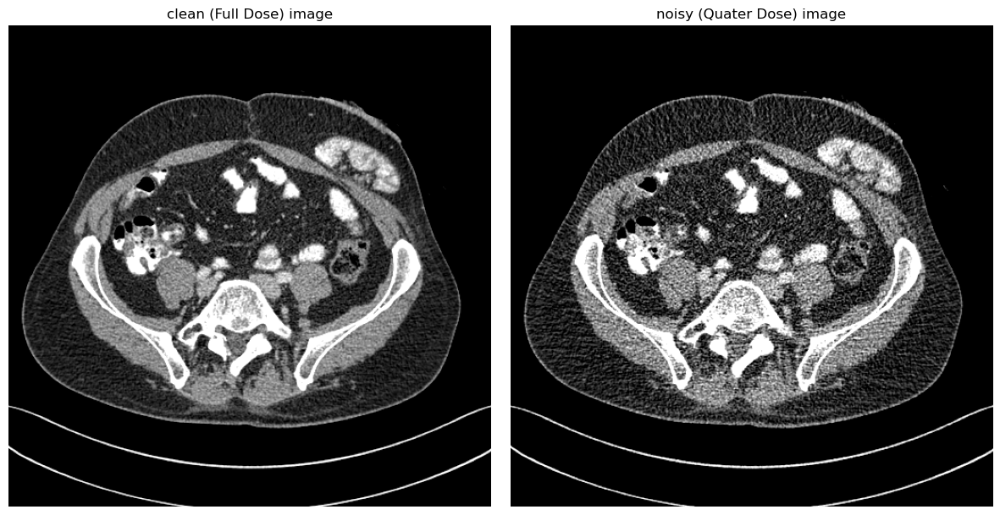

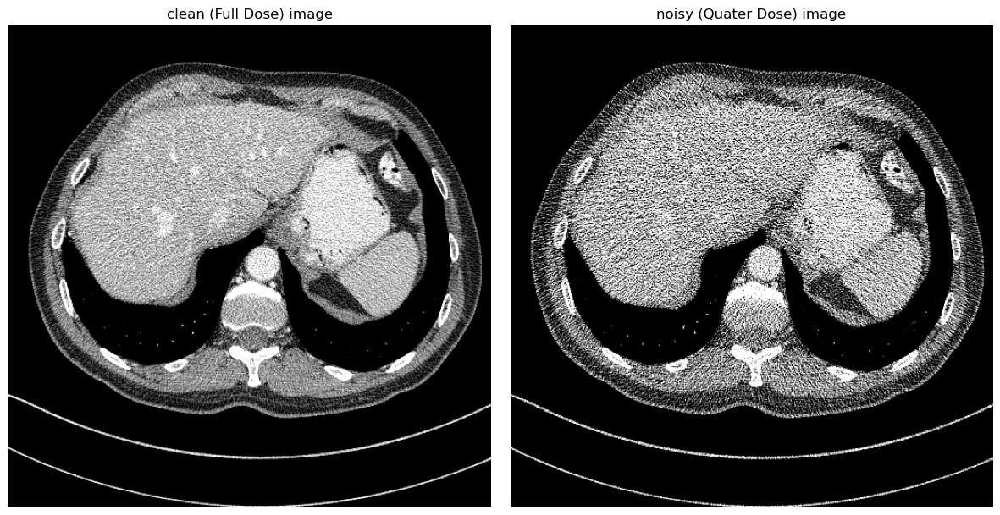

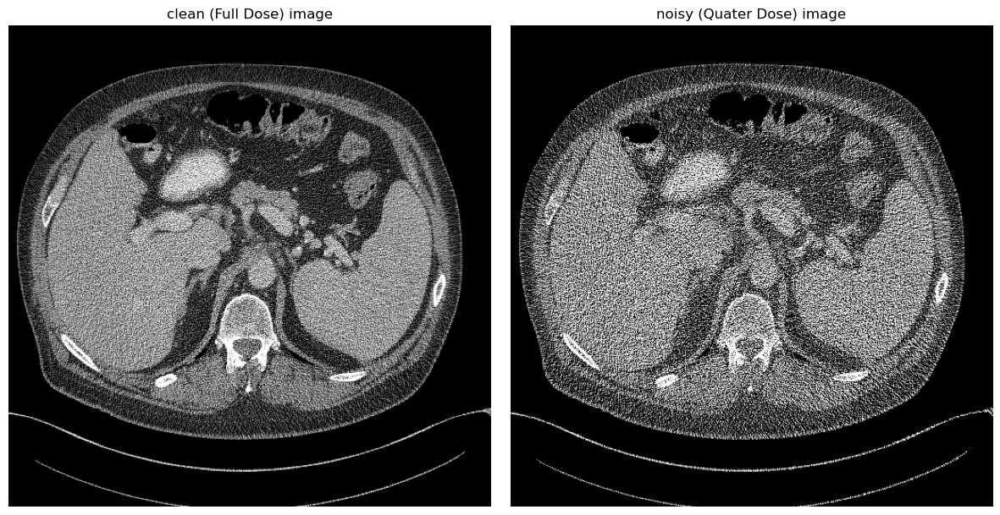

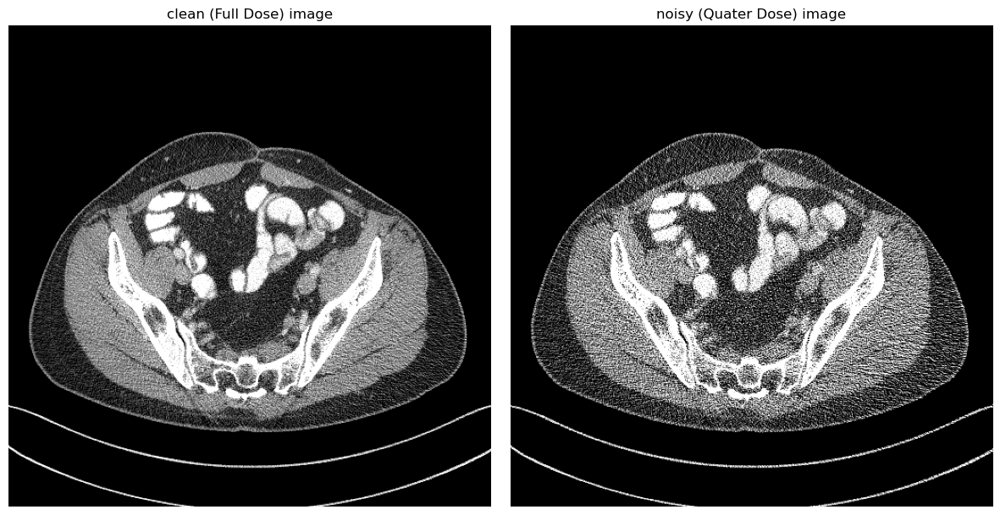

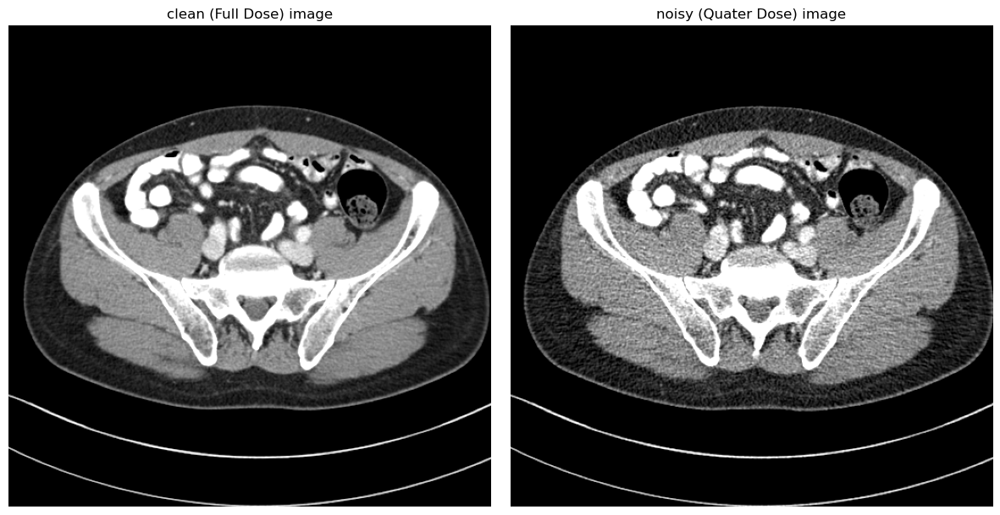

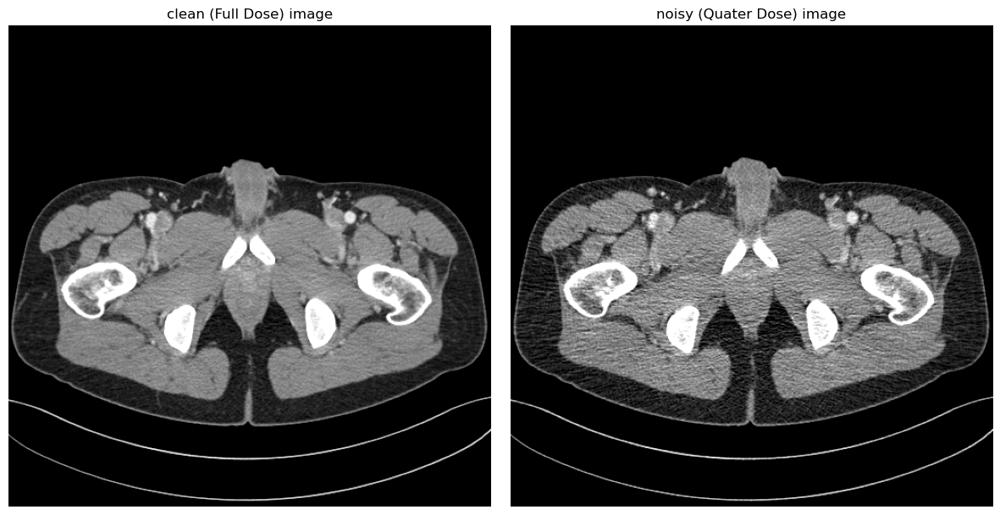

In [101]:
for i in range(0, 16000, 2000):
    noisy_image = read_image(training_filepaths_x[i])
    clean_image = read_image(training_filepaths_y[i])
    
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    
    axs[0].set_title('clean (Full Dose) image')
    axs[0].imshow(trunc(denormalize(clean_image)), cmap='gray', vmin=-160.0, vmax=240.0)
    axs[0].axis('off')  # Turn off axis labels
    
    axs[1].set_title('noisy (Quater Dose) image')
    axs[1].imshow(trunc(denormalize(noisy_image)), cmap='gray', vmin=-160.0, vmax=240.0)
    axs[1].axis('off')  # Turn off axis labels
    
    plt.tight_layout()
    
    plt.show()